In this project we are required to build amodel which will be used to predict whether it will rain tomorrow or Not
IE classificatiion problem (logistic regression)


In [1]:
# DOWN LOADING DATA SET
# WE WILL USE 'opendatasets library to down load data from kaggle directly wihtn jupyter notebook

# install opendatasets lib
# !pip install opendatasets --upgrade --quiet 


In [1]:
#  importing opendatasets 
import opendatasets as od


In [4]:
dataset_url = 'https://www.kaggle.com/datasets/jsphyg/weather-dataset-rattle-package'
# od.download(dataset_url)

In [5]:
import os

# listing the files/diectory  in the data directory  , by calling 'listdir' on 'os' model 
data_dir_url = './weather-dataset-rattle-package'
# os.listdir(data_dir_url)




In [6]:
# then making a url of the of the file containing the data we are interested in 
train_csv = data_dir_url + '/weatherAUS.csv'
# print(train_csv)

In [7]:
# then opening the file with pandas
import pandas as pd
weather_df = pd.read_csv(train_csv)
weather_df


,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145455,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
145456,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
145457,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
145458,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No


In [8]:
# understanding the data set
weather_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 23 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Date           145460 non-null  object 
 1   Location       145460 non-null  object 
 2   MinTemp        143975 non-null  float64
 3   MaxTemp        144199 non-null  float64
 4   Rainfall       142199 non-null  float64
 5   Evaporation    82670 non-null   float64
 6   Sunshine       75625 non-null   float64
 7   WindGustDir    135134 non-null  object 
 8   WindGustSpeed  135197 non-null  float64
 9   WindDir9am     134894 non-null  object 
 10  WindDir3pm     141232 non-null  object 
 11  WindSpeed9am   143693 non-null  float64
 12  WindSpeed3pm   142398 non-null  float64
 13  Humidity9am    142806 non-null  float64
 14  Humidity3pm    140953 non-null  float64
 15  Pressure9am    130395 non-null  float64
 16  Pressure3pm    130432 non-null  float64
 17  Cloud9am       89572 non-null

the data set containes 145460 rows of data with 23 columns. where some are categorical and others are numerical.
some columns contain null values (NAN).

now since the target column ie ' rain tomorrow' contains a null values, we need to drop all of those rows which containes null in that row. NOTE since rain tomorrow also heavly depends whether it has rained today, then we need to drop all of those columns with null values in rained today columns. 

In [23]:
# dropping null values using 'dropna()'

weather_df.dropna(subset= ['RainToday','RainTomorrow'], inplace=True)
weather_df.info()



<class 'pandas.core.frame.DataFrame'>
Index: 140787 entries, 0 to 145458
Data columns (total 23 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Date           140787 non-null  object 
 1   Location       140787 non-null  object 
 2   MinTemp        140319 non-null  float64
 3   MaxTemp        140480 non-null  float64
 4   Rainfall       140787 non-null  float64
 5   Evaporation    81093 non-null   float64
 6   Sunshine       73982 non-null   float64
 7   WindGustDir    131624 non-null  object 
 8   WindGustSpeed  131682 non-null  float64
 9   WindDir9am     131127 non-null  object 
 10  WindDir3pm     137117 non-null  object 
 11  WindSpeed9am   139732 non-null  float64
 12  WindSpeed3pm   138256 non-null  float64
 13  Humidity9am    139270 non-null  float64
 14  Humidity3pm    137286 non-null  float64
 15  Pressure9am    127044 non-null  float64
 16  Pressure3pm    127018 non-null  float64
 17  Cloud9am       88162 non-null   fl

EXPLORATORY DATA ANALYSIS AND VISUALIZATIONS
    getting to know our data set

In [9]:
import plotly.express as px
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [14]:
# invisting where it rained location
fg1 = px.histogram(
    weather_df,
    x="Location",
    title= "Graph showing number of days it Rained Vs dayas it Didn't Rain for a different  locations",
    color="RainToday")
fg1.show()

EXPLANATIONS
the graph generally show a unifrom distribution for both (yes, no) which inducts that all the places exprienced almost the same number of days of when it rained and when it didnt rain expect for few locations like Nhil, Uluru,and  Katherine.
which may indicate :
1. Climatic Homogeneity Across Locations
The uniformity suggests that the climate patterns — specifically, rainfall occurrence — are very similar across all the locations being analyzed. This might imply that the locations fall within the same climatic zone or region with minimal geographical variation influencing rainfall.
Conclusion: about 20% of days it rained in all locations and about 80% of days it didnt rain in all locations. 

In [16]:
# invisting distribution of rain tomorow given tempreture at 3 pm of today
fg1 = px.histogram(
    weather_df,
    x="Temp3pm",
    title= "Graph showing Tempreture At 3 pm Vs Rain Tomorow ",
    color="RainTomorrow")
fg1.show()

Explanation:
    histogram for rain tomorow vs tempreture today and 3 pm with a sumption that if the tempreture today at 3 pm is low, then it might rain tomorow. the histogram forms a shape like a norma distribution (for both it will rain tomorow and it will not ). indicting that it rained in cases where tempreture is in normal range ie btn 10 to 30 and in some cases it has not rained when the tempreture is in normal range

In [17]:
# distribution of rain tomorow and today
fg1 = px.histogram(
    weather_df,
    x="RainToday",
    title= "Graph showing Rain Today Vs Rain Tomorow ",
    color="RainTomorrow")
fg1.show()

EXPLANATION
the graph show class imbalances ie different number of observtions for the same data set.
interpretation of the graph: 
1. there are 92.7 counts where it didnt  rain today and 16.6 counts rain tomorow 
2. then 16.85 counts it rained today and 14.597k counts rain tomorow. indicting that there are high chances that when it rain today,
it may rain tomorrow

In [19]:
# invistigating relationships 
fig5 = px.scatter(
    weather_df,
    x= "MinTemp",
    y= "MaxTemp",
    color ="RainToday",
    title= "Relationship btn Min and Max temp"
    
)
fig5.show()

explanation:
it forms a linear relationship and it looks like when mintemp and max temp are low, its more likely to rain today 

In [26]:
fig6 = px.scatter(
    weather_df,
    x= "Temp3pm",
    y= "Humidity3pm",
    color ="RainTomorrow",
    title= "Relationship btn humidity and tempreture at 3 pm "
    
)
fig6.show()

explanation: it looks like when the tempreture is moderate high humudity, it will rain tomorow and when temp is high 
and humudity is low, it may not rain tomorow 

In [27]:
from sklearn.model_selection  import  train_test_split


SPLITTING DATA SET INTO training set 60% of the data, validation set 20% of the data and test set ie 20% of the data
using trian_test_split from sklearn.model_selecton . note that random_state arg means that for everytime the notebook run, the random 
smaple wont change, but if it is not specified / ignored, then every time a notebook is run, the sample changes 

In [28]:
training_validation_set, test_set = train_test_split(
    weather_df,
    test_size = 0.2,
    random_state = 42
)

training_set, validation_set = train_test_split(
    training_validation_set, test_size = 0.25,
    random_state = 42
)

In [39]:

print(f"train set: {training_set.shape}")
print(f"validation set: {validation_set.shape}")
print(f"train set: {test_set.shape}")

train set: (87276, 23)


NOTE:
    since data is a time serie data (ie it invole year or time, ) it is better we split data sets depending on the time frame in oder to 
    prevent model from using using future data to predict passed data, 
    ie from the data set we have it 2007 to 2017 as shown bellow. so just picking a random set as we did above may indict a senario where 2017 data is being used to rain a model to predict 2010, during testing phase, so that's why spliting by years/ time frame is very important for time serrie data sets 

<Axes: title={'center': 'No of rows per year'}, xlabel='Date', ylabel='count'>

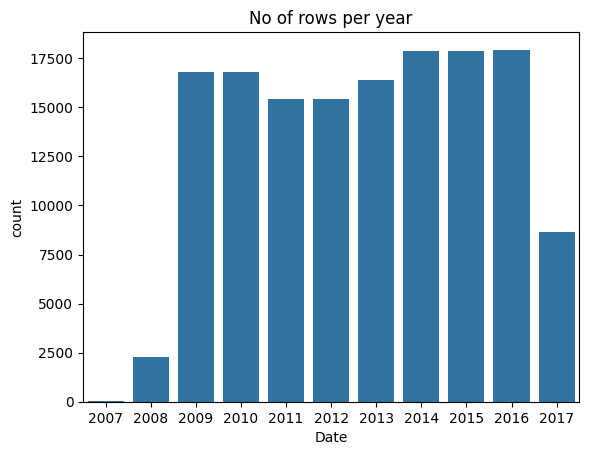

In [41]:
plt.title("No of rows per year")
sns.countplot(x=pd.to_datetime(weather_df.Date).dt.year)

In [47]:
#  there for 

years  = pd.to_datetime(weather_df.Date).dt.year


# now splitting 

training_set = weather_df[years < 2015]
validation_set = weather_df[years == 2015]
testing_set = weather_df[years > 2015]
training_set.shape

(101018, 23)